In [1]:
import warnings
import pandas as pd
import numpy as np
%matplotlib inline
import seaborn as sns
import matplotlib as plt
import lightgbm as lgb
import xgboost as xgb
import time
import matplotlib.pyplot as plt

from catboost import CatBoostClassifier, Pool

from matplotlib.colors import ListedColormap

from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score
from sklearn.preprocessing import LabelEncoder
from scipy import stats
from collections import defaultdict

from ucimlrepo import fetch_ucirepo
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from pprint import pprint

warnings.filterwarnings("ignore")

In [8]:
import sys 
print(sys. version)

3.9.19 (main, Mar 21 2024, 12:07:41) 
[Clang 14.0.6 ]


# Homework #05: Ensemble

**Оформление ДЗ**:

- Выполненное ДЗ сохраните в файл ``ml_b2c2024q2_<фамилия>_HW04.ipynb`` (пример ``ml_b2c2024q2_dral_HW05.ipynb``)
- Зарегистрироваться и залогиниться в сервисе [Everest](https://everest.distcomp.org/)
- Перейти на страницу приложения: [BDT-grader-ML-B2C](https://everest.distcomp.org/apps/BigDataTeam/BDT-grader-ML-B2C)
- Выбрать вкладку Submit Job (если отображается иная).
- Выбрать в качестве “Task” значение: ``HW05:ML Ensembles`` (кодовое название для преподвателей: ``ml.ensembles05``)
- Загрузить в качестве “Task solution” файл с решением
- В качестве Access Token указать тот, который был выслан по почте или в телеграм от аккаунта @bdt_manager

**Вопросы**:
- Свои вопросы присылайте в Телеграм.

**Фидбек**:
- Пожалуйста, оставьте свой отзыв после выполнения домашнего задания по сссылке:

    https://forms.gle/iY5NRn9UfaZ344rbA

# Задание 0 - Вопросы на понимание (5%)

1. Какую часть ошибки мы надеемся уменьшить блендингом? Модели какой сложности мы хотим видеть в ансамбле?
2. Является ли AdaBoost частным случаем Градиентного бустинга? Почему?
3. Если на тестовой выборке ошибка намного больше чем на трейне, то с каким эффектом мы столкнулись?
4. Склонен ли бустинг к переобучению? Если да, то как можно его уменьшить?

##Ответы
1. Блендинг не имеет прямой интерпретации в с точки зрения смещения и разброса, он просто уменьшает ошибку и как следствие ее компоненты будут убывать. Мы хотим видеть модели одинаковой сложности в блендингне, что бы слабые модели не снижали качество сильных моделей.
2. Да, AdaBoost является частным случаем градиентного бустинга, переобучение по весам делается по тому же вектору невязок, используется выпуклая экспоненциальная функциия потерь вида:
   $$
   L(y,x) = e^{-zy}
   $$
3. Это переобучение модели
4. Да, бустинг склонен к переобучению, его надо контролировать - ранний стоп по количеству деревьев, ограничиваем гдубину дерева, отимизируем learning rate, используем L1, L2 регуляризацию.

# Задание 1 - Практика (95%)

Мы хотим попробовать и сравнить все три реализации градиентного бустинга

In [ ]:
#pip install ucimlrepo

Сегодня вам предстоит поработать с известным датасетом adultl. Описание датасета: https://archive.ics.uci.edu/dataset/2/adult

In [2]:

# Скачаем датасет
adult = fetch_ucirepo(id=2)
#adult = pd.read_csv('adult.data')
#adult.info()

In [3]:
# data (as pandas dataframes)
X = adult.data.features
y = adult.data.targets
#X = pd.read_parquet('adult_X.prq')
#y = pd.read_parquet('adult_y.prq')
y['income'] = y['income'].str.replace('.','').values

In [4]:
X.describe(include='all')
X[X.isna().any(axis=1)]
df2 = X.dropna(how='all').dropna(how='all', axis=1)
X.isna().any()

age               False
workclass          True
fnlwgt            False
education         False
education-num     False
marital-status    False
occupation         True
relationship      False
race              False
sex               False
capital-gain      False
capital-loss      False
hours-per-week    False
native-country     True
dtype: bool

In [7]:
def fill_na(data, columns):
    for column in columns:
        data[column] = data[column].fillna(data[column].value_counts().idxmax())
fill_na(X, ['workclass', 'occupation', 'native-country'])

Сделаем выборки для обучения и тестирования

In [6]:
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

In [3]:
#X.to_parquet('adult_X.prq', index=False)
#y.to_parquet('adult_y.prq', index=False)
X = pd.read_parquet('adult_X.prq')
y = pd.read_parquet('adult_y.prq')

In [7]:
categorical_features_indices = np.where(x_train.dtypes != np.int64)[0]
cat_feats = list(x_train.columns[categorical_features_indices])

final_roc_auc=defaultdict(dict)


## 1.1 Обучите три алгоритма LightGBM, CatBoost и XGBoost c дефолтными параметрами. (15%)

Сделайте fit-predict и посчитайте ROC-AUC на отложенной выборке для каждого из алогритмов с дефолтными параметрами. Постройте кривые обучения и валидации. Сделайте выводы.  

*5% за каждый*

__Внимание__: не используйте для валидации x_test и y_test, чтобы не переобучиться под них.


[LightGBM] [Info] Number of positive: 8214, number of negative: 25975
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001501 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 706
[LightGBM] [Info] Number of data points in the train set: 34189, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.240253 -> initscore=-1.151295
[LightGBM] [Info] Start training from score -1.151295


<Axes: title={'center': 'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

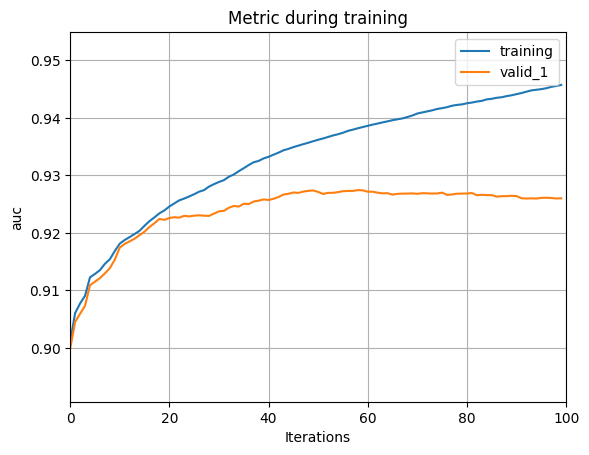

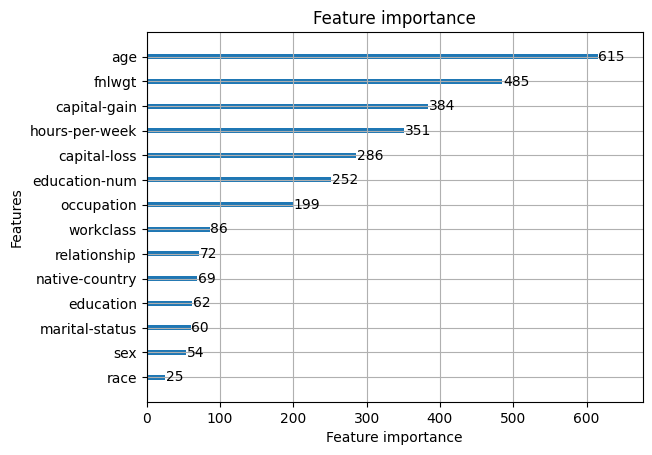

In [10]:
#LightGBM

lgb_x_test, lgb_x_train, lgb_y_test, lgb_y_train = x_test.copy(), x_train.copy(), y_test.copy(), y_train.copy()

def encode_categorical(test, train, y_test, y_train, cat_feats):
    labelencoder = LabelEncoder()

    for col in cat_feats:
        train[col] = labelencoder.fit_transform(train[col])
        test[col] = labelencoder.fit_transform(test[col])

    for col in cat_feats:
        test[col] = test[col].astype('int')
        train[col] = train[col].astype('int')
    
    y_test['income'] = labelencoder.fit_transform(y_test['income'])
    y_train['income'] = labelencoder.fit_transform(y_train['income'])


encode_categorical(lgb_x_test, lgb_x_train, lgb_y_test, lgb_y_train, cat_feats)

trn_data = lgb.Dataset(lgb_x_train, label=lgb_y_train, categorical_feature = cat_feats)
val_data = lgb.Dataset(lgb_x_test, label=lgb_y_test, categorical_feature = cat_feats)

param = {
    'boost': 'gbdt',
    'metric':'auc',
    'num_threads': 12,
    'objective': 'binary', 
}

evals = {} # Будем тут хранить историю
lgb_model = lgb.train(param, trn_data, valid_sets = [trn_data, val_data], 
               callbacks = [lgb.record_evaluation(evals)])
lgb.plot_metric(evals)
predictions = lgb_model.predict(lgb_x_test)
roc_auc = roc_auc_score(lgb_y_test, predictions)
final_roc_auc['Default']['LightGBM'] = roc_auc

lgb.plot_importance(lgb_model)


In [11]:
#Catboost
labelencoder = LabelEncoder()
cb_x_test, cb_x_train, cb_y_test, cb_y_train = x_test.copy(), x_train.copy(), y_test.copy(), y_train.copy()
cb_y_test['income'] = labelencoder.fit_transform(cb_y_test['income'])
cb_y_train['income'] = labelencoder.fit_transform(cb_y_train['income'])
test_data = Pool(cb_x_test, cb_y_test, cat_features=cat_feats)

cb_model = CatBoostClassifier(
                           verbose=False,
                           eval_metric='AUC',
                            random_state = 42,
                           #loss_function='CrossEntropy',                           #early_stopping_rounds=100,
                           #random_strength=0,
                           #l2_leaf_reg=52,
                           )
# train the model
cb_model.fit(cb_x_train,
          cb_y_train, 
          cat_features=cat_feats,
          plot=True,
          eval_set=test_data)
predictions = cb_model.predict_proba(cb_x_test)
roc_auc = roc_auc_score(lgb_y_test, predictions[:,1])

final_roc_auc['Default']['CatBoost'] = roc_auc

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

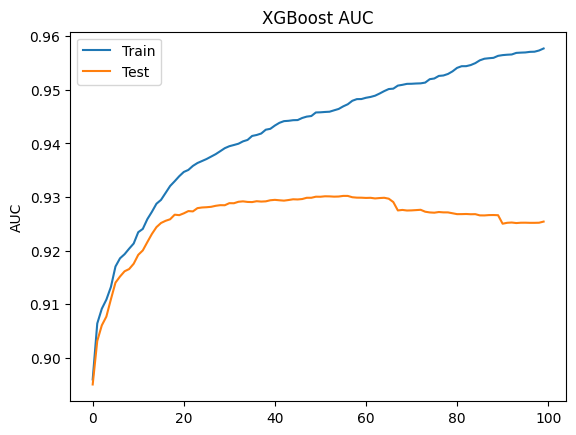

Default Xboost ROC-AUC 0.9254171974243424


In [12]:
#XGBoost

xgb_x_test, xgb_x_train, xgb_y_test, xgb_y_train = x_test.copy(), x_train.copy(), y_test.copy(), y_train.copy()

xgb_model = xgb.XGBClassifier(objective='binary:logistic', eval_metric=['auc'], verbose = 0)

encode_categorical(xgb_x_test, xgb_x_train, xgb_y_test, xgb_y_train, cat_feats)

xgb_model.fit(xgb_x_train, xgb_y_train, eval_set=[(xgb_x_train, xgb_y_train), (xgb_x_test,xgb_y_test)], verbose = 0)

predictions = xgb_model.predict_proba(xgb_x_test)
results = xgb_model.evals_result()

epochs = len(results['validation_0']['auc'])
x_axis = range(0, epochs)
fig, ax = plt.subplots()
ax.plot(x_axis, results['validation_0']['auc'], label='Train')
ax.plot(x_axis, results['validation_1']['auc'], label='Test')
ax.legend()
plt.ylabel('AUC')
plt.title('XGBoost AUC')
plt.show()

roc_auc = roc_auc_score(xgb_y_test, predictions[:,1])

print(f'Default Xboost ROC-AUC {roc_auc}')
final_roc_auc['Default']['XGBoost'] = roc_auc


In [13]:
## Сравнение ROC AUC
pprint(final_roc_auc)

defaultdict(<class 'dict'>,
            {'Default': {'CatBoost': 0.9325859930452501,
                         'LightGBM': 0.9260220422611024,
                         'XGBoost': 0.9254171974243424}})


## 1.2 Настройте  LightGBM, CatBoost и XGBoost (45%)
- Теперь, проведя серию экспериментов, нужно подобрать гипперпараметры для каждого из бустингов (вы можете использовать Random Search или Grid Search, однако помните, что вы не должны использовать для кроссвалидации данные из теста), чтобы добиться лучшего качества (метрика: ROC-AUC) на отложенной выборке от каждого алгоритма.
- При подборе паметров, руководствуйтесь:
    - Выводами из кривых обучения и валидации
    - Используйте подсказки из документаций [CatBoost](https://catboost.ai/en/docs/concepts/parameter-tuning),[LightGBM](https://lightgbm.readthedocs.io/en/latest/Parameters-Tuning.html) или другие материалы.
- Не забывайте делать промежуточные выводы при подборе и пояснять какой параметр и для чего подбирается.
- Не смотря на то, что в этом задании не требуется заниматься генерацией признаков, не забывайте и про добавление категориальных признаков.

*15% за каждый*

__Внимание__: не используйте для валидации x_test и y_test, чтобы не переобучиться под них

In [29]:
# для всех используем RandomSearchCV n_iter = 100
n_iter = 10

# Light GBM
lgb_model = lgb.LGBMClassifier(
          num_threads = 12, 
          n_jobs = -1, 
          verbose = -1,
          random_state = 42,
          early_stopping = 100,
    
)
params = {
    "boosting_type":['gbdt'],
    "metric": ['auc'], 
    "objective":['binary'],
    "n_estimators": np.arange(20, 1000, 10),
     "max_depth": [1,2,5,7,10],
    "lambda_l1": np.linspace(0.01, 4.0, 10),
    "lambda_l2": np.linspace(0.01, 4.0, 10),
    "num_leaves": np.linspace(2, 256, 20, dtype = int),
    "feature_fraction": np.linspace(0.4, 1.0, 10),
    "bagging_fraction": np.linspace(0.4, 1.0, 10),
    "bagging_freq": np.linspace(1, 5, 2, dtype = int),
    "min_child_samples": np.linspace(5, 100, 40, dtype=int),
}
lgb_grid = RandomizedSearchCV(lgb_model, params, n_jobs = -1,
                                 scoring = 'roc_auc', verbose = 0, n_iter=n_iter)

lgb_grid.fit(lgb_x_train, lgb_y_train.values.ravel(), eval_set = (lgb_x_test, lgb_y_test.values.ravel()))


RandomizedSearchCV(estimator=LGBMClassifier(early_stopping=100, n_jobs=-1,
                                            num_threads=12, random_state=42,
                                            verbose=-1),
                   n_jobs=-1,
                   param_distributions={'bagging_fraction': array([0.4       , 0.46666667, 0.53333333, 0.6       , 0.66666667,
       0.73333333, 0.8       , 0.86666667, 0.93333333, 1.        ]),
                                        'bagging_freq': array([1, 5]),
                                        'boosting_type': ['gbdt'],
                                        'feature_fraction': array([0.4       , 0.46666667,...
                                        'max_depth': [1, 2, 5, 7, 10],
                                        'metric': ['auc'],
                                        'min_child_samples': array([  5,   7,   9,  12,  14,  17,  19,  22,  24,  26,  29,  31,  34,
        36,  39,  41,  43,  46,  48,  51,  53,  56,  58,  61,  63,  65,
        68,  70,  73,  75,  78,  80,  82,  85,  87,  90,  92,  95,  97,
       100]),
                                        'n_estimators': array([20, 30, 40, 50]),
                                        'num_leaves': array([  2,  15,  28,  42,  55,  68,  82,  95, 108, 122, 135, 149, 162,
       175, 189, 202, 215, 229, 242, 256]),
                                        'objective': ['binary']},
                   scoring='roc_auc')

In [ ]:
predictions = lgb_grid.best_estimator_.predict_proba(lgb_x_test)

roc_auc = roc_auc_score(lgb_y_test, predictions[:,1])
final_roc_auc['Best']['LightGBM'] = roc_auc
print(f'Best LightGBM ROC-AUC {roc_auc}')

Best LightGBM ROC-AUC 0.9202789709873606


In [16]:
#CatBoost

import shap
shap.initjs() 

cb_model = CatBoostClassifier(iterations=300, learning_rate=0.1, random_seed=42)
cb_model.fit(cb_x_train, cb_y_train, cat_features=cat_feats, verbose=False, plot=False)


In [34]:
shap_values = cb_model.get_feature_importance(Pool(cb_x_train, cb_y_train, cat_features=cat_feats), type='ShapValues')

expected_value = shap_values[0,-1]
shap_values = shap_values[:,:-1]

In [18]:
shap.force_plot(expected_value, shap_values[0,:], cb_x_train.iloc[0,:])

In [ ]:
cb_model = CatBoostClassifier(
          verbose = 0,
          random_state = 42,
          eval_metric = 'AUC:hints=skip_train~false',
#         early_stopping = 100,
    
)
params = { 
     "n_estimators": stats.randint(10, 1000),
    'learning_rate': stats.uniform(0.01, 1.0)
     "max_depth": np.arange(2,11),
     "l2_leaf_reg": np.linspace(3, 60, 10),
     "subsample": stats.uniform(0.3, 0.8),
     "colsample_bylevel": np.linspace( 0.1, 1.0, 10),
     "min_data_in_leaf": np.linspace( 30, 200, 10),
}
cb_train_pool = Pool(cb_x_train, cb_y_train, cat_features=cat_feats)
cb_test_pool = Pool(cb_x_test, cb_y_test, cat_features=cat_feats)

#cb_model.randomized_search(params, X=cb_train_pool)

cb_grid = RandomizedSearchCV(cb_model, param_distributions = params, n_iter = n_iter, scoring = 'roc_auc', 
                         error_score = 0, verbose = 0, n_jobs = -1, random_state = 42)
cb_grid.fit(cb_x_train, cb_y_train, cat_features = cat_feats, eval_set = [(cb_x_test, cb_y_test)])


RandomizedSearchCV(error_score=0,
                   estimator=<catboost.core.CatBoostClassifier object at 0x151a7c790>,
                   n_jobs=-1,
                   param_distributions={'colsample_bylevel': array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
                                        'l2_leaf_reg': array([ 3.        ,  9.33333333, 15.66666667, 22.        , 28.33333333,
       34.66666667, 41.        , 47.33333333, 53.66666667, 60.        ]),
                                        'max_depth': [1, 2, 5, 7, 10],
                                        'min_data_in_leaf': a...
        910,  920,  930,  940,  950,  960,  970,  980,  990, 1000, 1010,
       1020, 1030, 1040, 1050, 1060, 1070, 1080, 1090, 1100, 1110, 1120,
       1130, 1140, 1150, 1160, 1170, 1180, 1190, 1200, 1210, 1220, 1230,
       1240, 1250, 1260, 1270, 1280, 1290, 1300, 1310, 1320, 1330, 1340,
       1350, 1360, 1370, 1380, 1390, 1400, 1410, 1420, 1430, 1440, 1450,
       1460, 1470, 1480, 1490]),
                                        'subsample': array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ])},
                   random_state=42, scoring='roc_auc')

In [ ]:
predictions = cb_grid.best_estimator_.predict_proba(cb_x_test)

roc_auc_cb = roc_auc_score(cb_y_test, predictions[:,1])
final_roc_auc['Best']['CatBoost'] = roc_auc
#pprint(cb_model.get_all_params())

NameError: name 'cb_grid' is not defined

In [30]:
param_dist = {'n_estimators': stats.randint(10, 1000),
              'learning_rate': stats.uniform(0.01, 1.0),
              'subsample': stats.uniform(0.3, 0.6),
              'max_depth': np.arange(2,11),
              'colsample_bytree': stats.uniform(0.5, 0.4),
              'min_child_weight': [1, 2, 3, 4],
              'lambda':stats.randint(1, 10)
             }
xgb_model = xgb.XGBClassifier(objective='binary:logistic', eval_metric=['auc'], verbosity = 0)
xgb_grid = RandomizedSearchCV(xgb_model, param_distributions = param_dist, n_iter = 200, scoring = 'roc_auc', 
                         error_score = 0, verbose = 0, n_jobs = -1, random_state = 42)
xgb_grid.fit(xgb_x_train, xgb_y_train, eval_set = [(xgb_x_test, xgb_y_test)])

[0]	validation_0-auc:0.86000
[1]	validation_0-auc:0.89115
[0]	validation_0-auc:0.86326
[0]	validation_0-auc:0.86083
[0]	validation_0-auc:0.85986
[0]	validation_0-auc:0.86219
[1]	validation_0-auc:0.89207
[1]	validation_0-auc:0.89248
[1]	validation_0-auc:0.89164
[2]	validation_0-auc:0.90300
[2]	validation_0-auc:0.90209
[2]	validation_0-auc:0.90235
[2]	validation_0-auc:0.90356
[3]	validation_0-auc:0.90994
[1]	validation_0-auc:0.88928
[3]	validation_0-auc:0.91054
[3]	validation_0-auc:0.90843
[3]	validation_0-auc:0.91182
[4]	validation_0-auc:0.91250
[4]	validation_0-auc:0.91247
[2]	validation_0-auc:0.90148
[4]	validation_0-auc:0.91379
[4]	validation_0-auc:0.91177
[0]	validation_0-auc:0.86261
[5]	validation_0-auc:0.91449
[5]	validation_0-auc:0.91547
[5]	validation_0-auc:0.91364
[0]	validation_0-auc:0.86132
[1]	validation_0-auc:0.89058
[6]	validation_0-auc:0.91557
[3]	validation_0-auc:0.91066
[5]	validation_0-auc:0.91623
[6]	validation_0-auc:0.91413
[1]	validation_0-auc:0.89294
[7]	validation

RandomizedSearchCV(error_score=0,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           callbacks=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None, device=None,
                                           early_stopping_rounds=None,
                                           enable_categorical=False,
                                           eval_metric=['auc'],
                                           feature_types=None, gamma=None,
                                           grow_policy=None,
                                           importance_type=None,
                                           interaction_constraints=None,
                                           l...
                                        'learning_rate': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x28efc6040>,
                                        'max_depth': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10]),
                                        'min_child_weight': [1, 2, 3, 4],
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x28ef5f6a0>,
                                        'subsample': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x28efe5a90>},
                   random_state=42, scoring='roc_auc')

In [32]:
predictions = xgb_grid.best_estimator_.predict_proba(xgb_x_test)

roc_auc_xgb = roc_auc_score(xgb_y_test, predictions[:,1])
final_roc_auc['Best']['XGBoost'] = roc_auc
print(f'Best XBoost ROC-AUC {roc_auc_xgb}')

Best XBoost ROC-AUC 0.9307116050369656


## 1.3 Постройте таблицу для сравнения всех трех алгоритмов (5%)

Таблица должна содержать сравнение ROC-AUC на отложенной выборке (`x_test`, `y_test`) для трех алгоритмов, каждый из которых имеет дефолтные настройки и настроенные по итогам задания 1.2.

In [ ]:
pprint(final_roc_auc)

defaultdict(<class 'dict'>,
            {'Default': {'CatBoost': 0.9325859930452501,
                         'LightGBM': 0.9260220422611024,
                         'XGBoost': 0.9254171974243424}})


## 1.4 Сравните скорость применения (25%)
1. На `train` выборке:
- Обучите XGBoost на 100, 200, ... 1500 деревьев
- Обучите LightGBM на 100, 200, ... 1500 деревьев
- Обучите CatBoost c разными `grow_policy` (SymmetricTree, Lossguide, Depthwise) на 100, 200, ... 1500 деревьев


Убедитесь, что в фашем финальном дереве одинаковое кол-во деревеьев. Например в CatBoost, есть параметр `use_best_model`, значение которого по-умолчанию `True`, это означает, что "лишние" деревья будут выкинуты. Обратите внимание и на другие параметры которые могут влиять на скорость применения. Не забудьте зафиксировать глубину деревьев (но не делайте их сильно маленькими, >5).

_Примечание_: здесь нам не очень важно качество обучения и наши ансамбли могут быть переобучены

2. Постройте график, показывающий как меняется скорость (время) применения на `test` в зависимости от кол-ва деревьев для каждого из 5 алгоритмов

In [20]:
max_iterations = np.arange(100, 1600, 100)
policies = ['SymmetricTree', 'Lossguide', 'Depthwise']
results = defaultdict(dict)
for iterations in max_iterations:

    for policy in policies:
        
        cb_model = CatBoostClassifier(
            verbose=False,
            eval_metric='AUC',
            max_depth = 10,
            random_state = 42,
            n_estimators = iterations,
            use_best_model = False,
            grow_policy = policy,
        )   
        cb_model.fit(cb_x_train,
              cb_y_train, 
              cat_features=cat_feats,
              plot=False,
              eval_set=test_data)
        start_time = time.time()
        cb_preds = cb_model.predict_proba(cb_x_test)
        end_time = time.time()
        results['CatBoost_'+policy][iterations] = end_time - start_time

    
    xgb_model = xgb.XGBClassifier(
        objective='binary:logistic', 
        eval_metric=['auc'], 
        max_depth = 10, 
        n_jobs = -1,
        verbose = 0, 
        n_estimators = iterations,
        random_state = 42)
    xgb_model.fit(xgb_x_train, xgb_y_train, eval_set=[(xgb_x_test,xgb_y_test)], verbose = 0)
    start_time = time.time()
    xgb_preds = xgb_model.predict_proba(xgb_x_test)
    end_time = time.time()
    results['XGBoost'][iterations] = end_time - start_time
  
    lgb_model = lgb.LGBMClassifier(
          num_threads = 12,
          metric = 'auc',
          max_depth = 10,
          n_jobs = -1, 
          verbose = -1,
          random_state = 42,
          n_estimators = iterations,    
    )

    lgb_model.fit(lgb_x_train, lgb_y_train.values.ravel(), eval_set = (lgb_x_test, lgb_y_test.values.ravel()))
    start_time = time.time()
    lgb_preds = lgb_model.predict_proba(xgb_x_test)
    end_time = time.time()
    results['LigthGBM'][iterations] = end_time - start_time

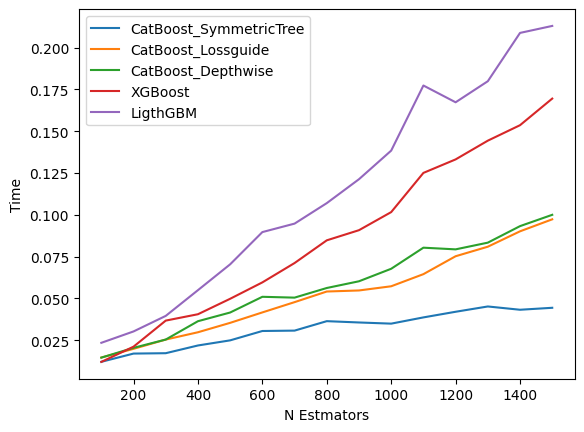

defaultdict(<class 'dict'>,
            {'CatBoost_Depthwise': {100: 0.014536142349243164,
                                    200: 0.02039313316345215,
                                    300: 0.025349855422973633,
                                    400: 0.03632473945617676,
                                    500: 0.04152703285217285,
                                    600: 0.050930023193359375,
                                    700: 0.050431013107299805,
                                    800: 0.056197166442871094,
                                    900: 0.06021928787231445,
                                    1000: 0.06770205497741699,
                                    1100: 0.08031392097473145,
                                    1200: 0.07931089401245117,
                                    1300: 0.08332490921020508,
                                    1400: 0.09321069717407227,
                                    1500: 0.09998083114624023},
             'CatBoost_Lossgui

In [21]:
for keys, values in results.items():
    lists = sorted(values.items()) # sorted by key, return a list of tuples

    x, y = zip(*lists) # unpack a list of pairs into two tuples

    plt.plot(x, y)
labels = results.keys()
plt.legend(labels)
plt.xlabel('N Estmators')
plt.ylabel('Time')    
plt.show()
pprint(results)

## 1.5. Бонус, факультатив и дополнительные баллы (+30%)

Бустинг, уже довольно тяжелый алгоритм, чтобы подбирать параметры перебором по сетке, при этом хочется подбирать их более осознанно, чем просто случайным поиском, надеясь, что мы "попадем" в удачную комбинацию параметров.   

Для этого существует множество подходов, в рамках сегодняшней работы, вам предлагается ознакомиться и попробовать Bayesian Optimization для подбора гиперпарметров, который использует вероятностную модель для уточнения "региона" поиска в пространстве комбинаций признаков.

Для начала, почитайте про этот подход:
- Статья [An introduction to Bayesian Optimization for HyperParameter tuning](https://jonathan-guerne.medium.com/an-introduction-to-bayesian-optimization-for-hyperparameter-tuning-4561825bf47b)
- Часть документации библиотеки [FB AX](https://ax.dev/docs/bayesopt.html)
- Часть документации библиотеки [syne-tune](https://syne-tune.readthedocs.io/en/latest/tutorials/dev_bayesopt/README.html)
- Более практическая статья на Хабре [Гиперпараметры: как перестать беспокоиться и начать их оптимизировать](https://habr.com/ru/companies/antiplagiat/articles/528384/)

Мы предлагаем вам попробовать Байесовскую оптимизацию для задачи 1.2, для этого:  
- Выберите любой (**один!**) алгоритм градиентного бустинга
- Выберите библиотеку (**одну!**), где реализована Байесовская оптимизация:
    - [Optuna](https://optuna.org)
    - [scikit-optimize](https://scikit-optimize.github.io/stable/modules/generated/skopt.BayesSearchCV.html)
    - [AX](https://github.com/facebook/Ax/tree/main) от Facebook
    - [syne-tune](https://github.com/awslabs/syne-tune) от AWS
- Подберите с ее помощью гиперпараметры
- Сделайте выводы, сравнив насколько эффективнее происходит поиск параметров, относительно поиска по сетке (Для примера, можете попровать сравнить время и итоговое качество с RandomSearch)

In [25]:
import optuna
def objective(trial):
    params = {
        'n_estimators': trial.suggest_int("n_estimators", 10, 1000),
        "learning_rate": trial.suggest_float("learning_rate", 1e-3, 1, log=True),
        "max_depth": trial.suggest_int("depth", 1, 10),
        "subsample": trial.suggest_float("subsample", 0.1, 1.0),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.1, 1.0),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 30, 200),
        "eval_metric": 'AUC',
        "l2_leaf_reg": trial.suggest_int("l2_leaf_reg", 3, 60),
        "loss_function": trial.suggest_categorical("loss_function", ['Logloss', 'CrossEntropy']),
    }

    cb_clf = CatBoostClassifier(**params, silent=True)
    cb_clf.fit(cb_x_train,
          cb_y_train, 
          cat_features=cat_feats,
          plot=False,
          eval_set = [(cb_x_test, cb_y_test)])
    
    predictions = cb_clf.predict_proba(cb_x_test) 
    roc_auc = roc_auc_score(cb_y_test, predictions[:,1])
    return roc_auc

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

[I 2024-04-30 01:49:20,751] A new study created in memory with name: no-name-2f92f1a4-2d8c-4a07-9f02-30ea5e35eac8
[I 2024-04-30 01:49:37,011] Trial 0 finished with value: 0.9288907993017436 and parameters: {'n_estimators': 650, 'learning_rate': 0.14675402494282805, 'depth': 9, 'subsample': 0.17695268694498334, 'colsample_bylevel': 0.6112198048228183, 'min_data_in_leaf': 117, 'l2_leaf_reg': 49, 'loss_function': 'Logloss'}. Best is trial 0 with value: 0.9288907993017436.
[I 2024-04-30 01:49:43,546] Trial 1 finished with value: 0.9286682931502771 and parameters: {'n_estimators': 589, 'learning_rate': 0.12961219732131649, 'depth': 3, 'subsample': 0.7828014479662206, 'colsample_bylevel': 0.7030218828451287, 'min_data_in_leaf': 200, 'l2_leaf_reg': 59, 'loss_function': 'Logloss'}. Best is trial 0 with value: 0.9288907993017436.
[I 2024-04-30 01:50:07,416] Trial 2 finished with value: 0.9311719412776405 and parameters: {'n_estimators': 844, 'learning_rate': 0.08940403224355005, 'depth': 9, 'su

In [26]:
study.best_params

{'n_estimators': 859,
 'learning_rate': 0.14540038986171505,
 'depth': 5,
 'subsample': 0.5841695841501852,
 'colsample_bylevel': 0.6647095349922487,
 'min_data_in_leaf': 63,
 'l2_leaf_reg': 9,
 'loss_function': 'CrossEntropy'}

In [27]:
study.best_value

0.9323356076289

## Решил ДЗ - дай обратную связь ;)

Надеемся, было интересно и полезно.

Пожалуйста, оставьте обратную связь по этому домашнему заданию: https://forms.gle/iY5NRn9UfaZ344rbA